In [509]:
import numpy as np
import os
from random import choice, randint
from PIL import Image, ImageOps
import pandas as pd
import matplotlib.pyplot as plt

In [510]:
def show_images(image_list):
    for i in image_list:
        plt.imshow(i)
        plt.pause(0.5)

In [511]:
stock_image_files=os.listdir("/Users/erikafox/bme548-meme-detector/data/stock-images")
stock_images=[]
for i in stock_image_files:
    if (i != ".DS_Store"):
        stock_images.append(Image.open("/Users/erikafox/bme548-meme-detector/data/stock-images/"+i).convert("RGBA"))
#show_images(stock_images)

In [512]:
stock_images[0].size[0]

540

In [513]:
nic_files=os.listdir("/Users/erikafox/bme548-meme-detector/data/Nicolas-Cage")
nic_images=[]
for i in nic_files:
    if (i != ".DS_Store"):
        nic_images.append(Image.open("/Users/erikafox/bme548-meme-detector/data/Nicolas-Cage/"+i).convert("RGBA"))

#show_images(nic_images)

In [514]:
def gen_memes(num_memes):
    memes=[]
    for i in range(0,num_memes):
        #randomly choose a nicpic and a stock_image
        stock=choice(stock_images)
        nic=choice(nic_images)

        # get new dimensions for nic sticker
        # this lets us shrink so will be smaller than background
        # but keeps it in proportion
        resize_height=int(stock.size[0]/15)
        resize_width= int((resize_height*nic.size[1])/nic.size[0])
        # shrink nic sticker
        nic=nic.resize((resize_height,resize_width))

        # get ranges for where sticker can go so 
        # it stays in bounds of the image
        max_height=stock.size[0]-nic.size[0]
        max_width=stock.size[1]-nic.size[1]
        height=randint(0,max_height)
        width=randint(0,max_width)

        # superimpose and add to meme list
        m=stock.copy()
        m.paste(nic, (height,width), mask = nic)
        memes.append(m)
    return pd.Series(memes)

In [515]:
def convertToArray(image_list):
    image_array_list=[]
    for i in image_list:
        image_array_list.append(np.asarray(i))
    return pd.Series(image_array_list)

def convertToImage(image_array_list):
    image_list=[]
    for i in image_array_list:
        image_list.append(Image.fromarray(i))
    return pd.Series(image_list)


In [516]:
memes=gen_memes(200)
name=0
for i in memes:
    i.save("/Users/erikafox/bme548-meme-detector/data/superimpose/"+str(name)+".png","PNG")
    name+=1

meme_arr=convertToArray(memes)

meme_arr.to_csv("/Users/erikafox/bme548-meme-detector/data/generated-memes/")

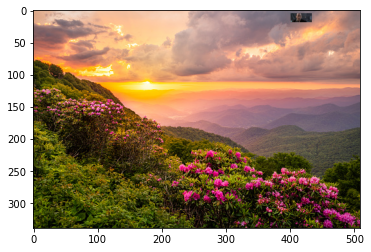

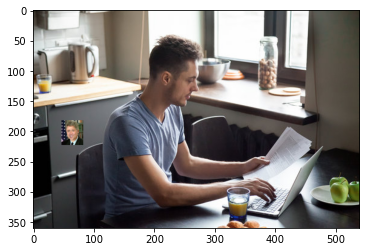

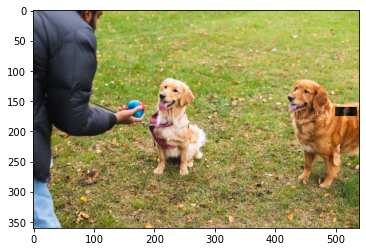

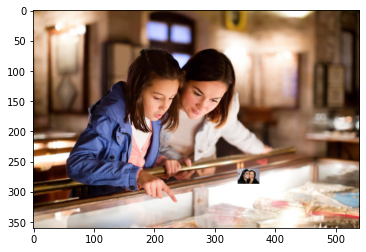

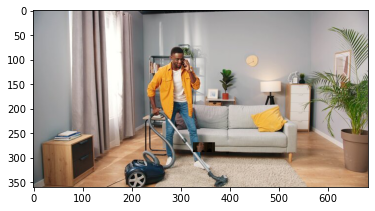

...

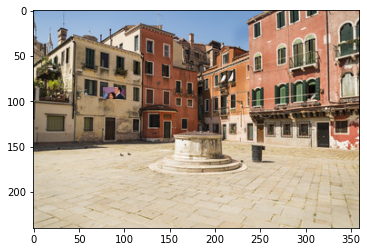

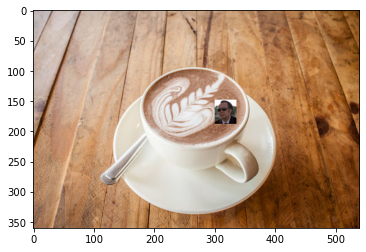

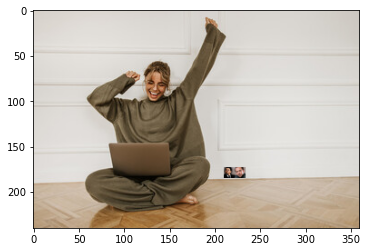

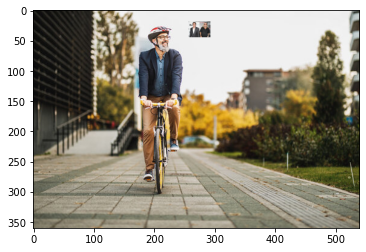

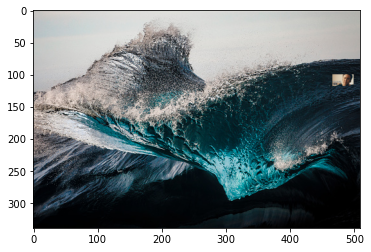

In [ ]:
show_images(convertToImage(meme_arr))